## Importando bibliotecas

In [1]:
#data manipulation
import pandas as pd
import numpy as np
import geopandas

#data visualization
import seaborn as sns
from matplotlib import pyplot as plt
import plotly.express as px
import folium
from folium.plugins import MarkerCluster

#ignore warnings
import warnings
warnings.filterwarnings("ignore")

#geocoder
import reverse_geocoder as rg

In [2]:
#desativa a notação científica
pd.set_option('display.float_format', lambda x: '%.2f' % x)

# 1. Extração dos dados

In [3]:
data = pd.read_csv('app/datasets/kc_house_data.csv')

# 2. Entendendo os dados

In [4]:
# Primeiras cinco linhas
data.head()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
0,7129300520,20141013T000000,221900.00,3,1.00,1180,5650,1.00,0,0,...,7,1180,0,1955,0,98178,47.51,-122.26,1340,5650
1,6414100192,20141209T000000,538000.00,3,2.25,2570,7242,2.00,0,0,...,7,2170,400,1951,1991,98125,47.72,-122.32,1690,7639
2,5631500400,20150225T000000,180000.00,2,1.00,770,10000,1.00,0,0,...,6,770,0,1933,0,98028,47.74,-122.23,2720,8062
3,2487200875,20141209T000000,604000.00,4,3.00,1960,5000,1.00,0,0,...,7,1050,910,1965,0,98136,47.52,-122.39,1360,5000
4,1954400510,20150218T000000,510000.00,3,2.00,1680,8080,1.00,0,0,...,8,1680,0,1987,0,98074,47.62,-122.05,1800,7503


In [5]:
# últimas cinco linhas
data.tail()

,id,date,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,...,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
21608,263000018,20140521T000000,360000.00,3,2.50,1530,1131,3.00,0,0,...,8,1530,0,2009,0,98103,47.70,-122.35,1530,1509
21609,6600060120,20150223T000000,400000.00,4,2.50,2310,5813,2.00,0,0,...,8,2310,0,2014,0,98146,47.51,-122.36,1830,7200
21610,1523300141,20140623T000000,402101.00,2,0.75,1020,1350,2.00,0,0,...,7,1020,0,2009,0,98144,47.59,-122.30,1020,2007
21611,291310100,20150116T000000,400000.00,3,2.50,1600,2388,2.00,0,0,...,8,1600,0,2004,0,98027,47.53,-122.07,1410,1287
21612,1523300157,20141015T000000,325000.00,2,0.75,1020,1076,2.00,0,0,...,7,1020,0,2008,0,98144,47.59,-122.30,1020,1357


In [6]:
# Número de linhas e colunas
print(f'There are {data.shape[0]} rows and {data.shape[1]} columns.')

There are 21613 rows and 21 columns.


## Significado das Colunas

- id - ID exclusivo para cada casa disponível
- date - Data em que a casa estava disponível para venda
- price - Preço de cada casa
- bedrooms - Numero de quartos
- bathrooms - Número de banheiros, onde 0,5 representa um quarto com vaso sanitário, mas sem chuveiro
- sqft_living - Metragem quadrada do espaço interior dos apartamentos
- sqft_lot - Metragem quadrada do terreno
- floors - Número de andares
- waterfront - Uma variável fictícia para saber se o apartamento estava com vista para a água ou não
- view - Um índice de 0 a 4 de quão boa era a vista da propriedade
- condition - Um índice de 1 a 5 sobre a condição do apartamento
- grade - Um índice de 1 a 13, onde 1-3 significa um nível baixo de construção e projeto do edifício, 7 tem um nível médio de construção e projeto e 11-13 tem um nível de alta qualidade de construção e projeto.
- sqft_above - A metragem quadrada do espaço interior da habitação que está acima do nível do solo
- sqft_basement - A metragem quadrada do espaço interior da habitação que está abaixo do nível do solo
- yr_built - O ano em que a casa foi construída
- yr_renovated - O ano da última reforma da casa
- zipcode - Em que área de código postal a casa está.
- lat - Latitude
- long - Longitude
- sqft_living15 - A metragem quadrada do espaço habitacional interior para os 15 vizinhos mais próximos
- sqft_lot15 - A metragem quadrada dos lotes dos 15 vizinhos mais próximos


In [7]:
# Verificando os tipos de dados
data.dtypes

id                 int64
date              object
price            float64
bedrooms           int64
bathrooms        float64
sqft_living        int64
sqft_lot           int64
floors           float64
waterfront         int64
view               int64
condition          int64
grade              int64
sqft_above         int64
sqft_basement      int64
yr_built           int64
yr_renovated       int64
zipcode            int64
lat              float64
long             float64
sqft_living15      int64
sqft_lot15         int64
dtype: object

In [8]:
# Estatística descritiva
data.describe()

,id,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_above,sqft_basement,yr_built,yr_renovated,zipcode,lat,long,sqft_living15,sqft_lot15
count,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00,21613.00
mean,4580301520.86,540088.14,3.37,2.11,2079.90,15106.97,1.49,0.01,0.23,3.41,7.66,1788.39,291.51,1971.01,84.40,98077.94,47.56,-122.21,1986.55,12768.46
std,2876565571.31,367127.20,0.93,0.77,918.44,41420.51,0.54,0.09,0.77,0.65,1.18,828.09,442.58,29.37,401.68,53.51,0.14,0.14,685.39,27304.18
min,1000102.00,75000.00,0.00,0.00,290.00,520.00,1.00,0.00,0.00,1.00,1.00,290.00,0.00,1900.00,0.00,98001.00,47.16,-122.52,399.00,651.00
25%,2123049194.00,321950.00,3.00,1.75,1427.00,5040.00,1.00,0.00,0.00,3.00,7.00,1190.00,0.00,1951.00,0.00,98033.00,47.47,-122.33,1490.00,5100.00
50%,3904930410.00,450000.00,3.00,2.25,1910.00,7618.00,1.50,0.00,0.00,3.00,7.00,1560.00,0.00,1975.00,0.00,98065.00,47.57,-122.23,1840.00,7620.00
75%,7308900445.00,645000.00,4.00,2.50,2550.00,10688.00,2.00,0.00,0.00,4.00,8.00,2210.00,560.00,1997.00,0.00,98118.00,47.68,-122.12,2360.00,10083.00
max,9900000190.00,7700000.00,33.00,8.00,13540.00,1651359.00,3.50,1.00,4.00,5.00,13.00,9410.00,4820.00,2015.00,2015.00,98199.00,47.78,-121.31,6210.00,871200.00


# 3. Preparação e Transformação

In [9]:
# Verificando valores faltantes
print(f"Há {data.isnull().sum().sum()} valores faltantes.")

Há 0 valores faltantes.


In [10]:
# Verificando valores duplicados
print(f"Há {data['id'].duplicated(keep='first').sum()} IDs duplicados")

Há 177 IDs duplicados


In [11]:
# Descarta IDs duplicados e mantém o ID mais recente
data = data.sort_values(by=['id', 'date']).drop_duplicates('id', keep='last')
print(f"Há {data['id'].duplicated(keep='first').sum()} IDs duplicados")

#reorder index
data.sort_index(inplace=True)

Há 0 IDs duplicados


In [12]:
# Convertendo a coluna de data para o tipo datetime
data['date'] = data['date'].astype('datetime64[ns]')

In [13]:
# Criando novas features
data['is_waterfront'] = data['waterfront'].apply(lambda x: 'yes' if x == 1 else 'no')
data['year'] = data['date'].dt.year
data['month'] = data['date'].dt.strftime('%B')
data['day'] = data['date'].dt.day
data['month-day'] = data['date'].dt.strftime('%m-%d')
data['location'] = list(zip(data.lat, data.long))
data['price/sqft'] = data['price'] / data['sqft_lot']

In [14]:
def season_of_year(date):
    year = str(date.year)
    
    seasons = { 'spring': pd.date_range(start='20/03/'+year, end='20/06/'+year),
                'summer': pd.date_range(start='21/06/'+year, end='22/09/'+year),
                'fall': pd.date_range(start='23/09/'+year, end='20/12/'+year) }

    if date in seasons['spring']:
        return 'spring'
    if date in seasons['summer']:
        return 'summer'
    if date in seasons['fall']:
        return 'fall'
    else:
        return 'winter'

In [15]:
# Estação do ano
data['season'] = data['date'].apply(season_of_year)

In [16]:
# Utilizando reverse geocoder para criar a feature "neighbourhood"
results = rg.search(list(data['location']))
neighbourhoods = [results[i]['name'] for i in range(len(results))]
data['neighbourhood'] = neighbourhoods

Loading formatted geocoded file...


In [17]:
# Construído antes de 1955?
data['built_bef_1955'] = data['yr_built'].apply(lambda year: 'yes' if year < 1955 else 'no')

In [18]:
# A condição da casa é nível 5?
data['is_condition5'] = data['condition'].apply(lambda condition: 'yes'if condition == 5 else 'no')

In [19]:
# O imóvel foi reformado?
data['was_renovated'] = data['yr_renovated'].apply(lambda year: 'yes' if year != 0 else 'no')

In [20]:
# O imóvel foi reformado depois de 2005?
data['renovated_after_2005'] = data['yr_renovated'].apply(lambda year: 'yes' if year > 2005 
                                                                             else 'never_renovated' if year == 0
                                                                             else 'no')

# 4. Análise Univariada

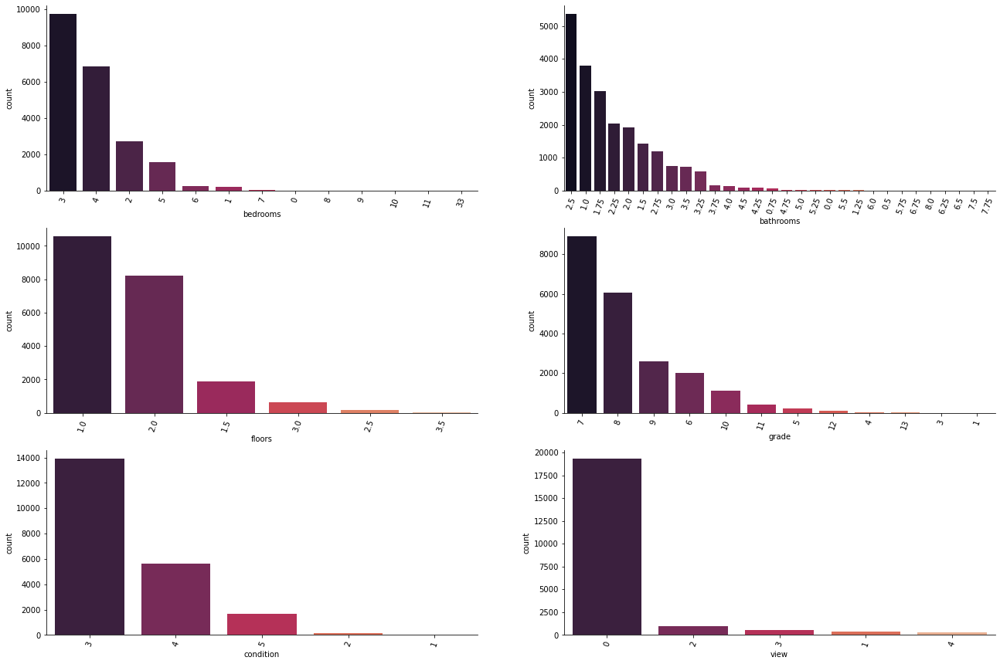

In [21]:
cols = ['bedrooms', 'bathrooms', 'floors', 'grade', 'condition', 'view']
plt.subplots(figsize=(22,15))

for i, col in enumerate(cols): 
    plt.subplot(3,2,i+1)
    sns.countplot(x=col, 
                  data=data,
                  order=data[col].value_counts().index,
                  palette='rocket')
    plt.xticks(rotation=70)
    sns.despine();

In [22]:
# Quantos imóveis estão em frente à água?
data.is_waterfront.value_counts()

no     21273
yes      163
Name: is_waterfront, dtype: int64

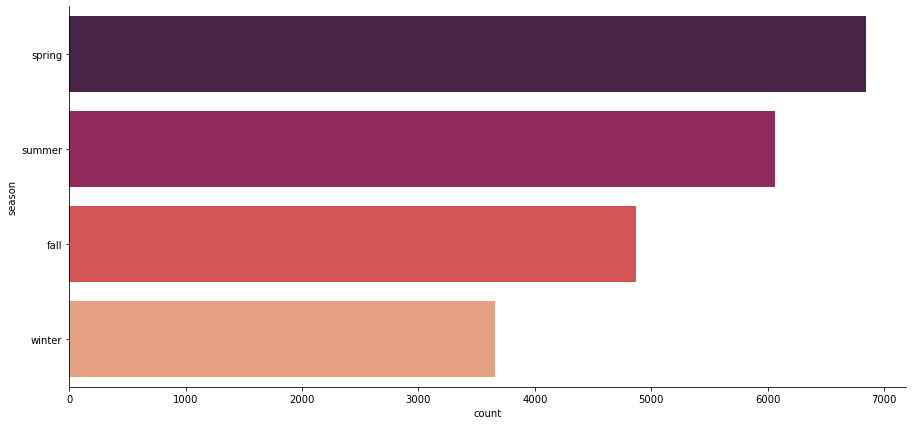

In [23]:
# Em qual estação os imóveis ficam disponíveis para compra?
plt.figure(figsize=(15,7))
sns.countplot(y = 'season', 
              data=data, 
              order=data['season'].value_counts().index,
              palette='rocket')

sns.despine()

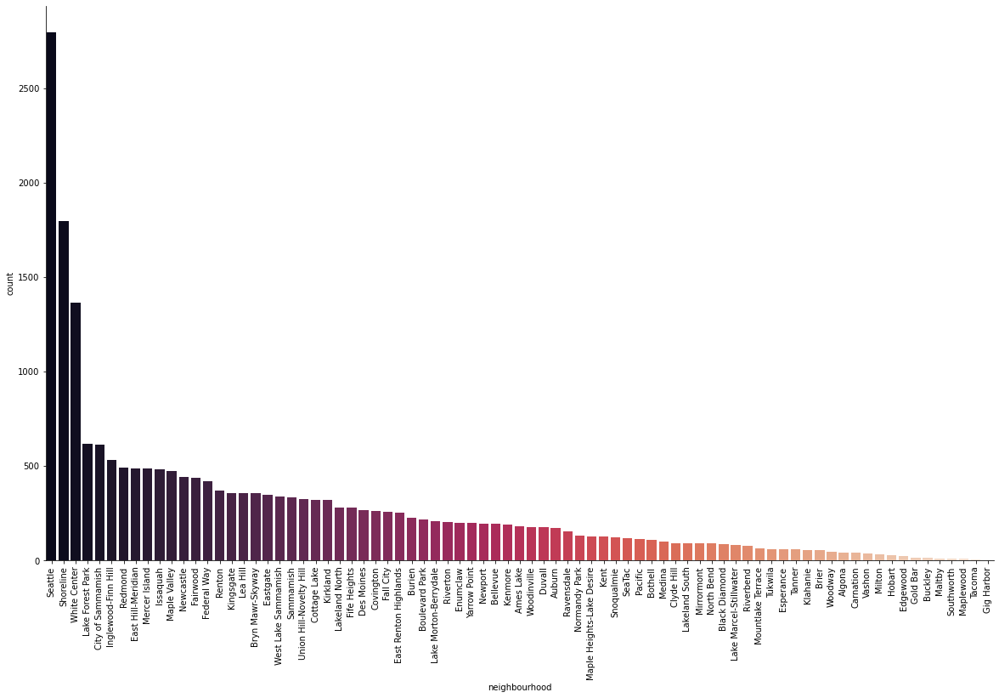

In [24]:
# As regiões com mais imóveis disponíveis
plt.figure(figsize=(20,12))

sns.countplot(x = 'neighbourhood', 
              data=data,
              order=data['neighbourhood'].value_counts().index,
              palette='rocket')
plt.xticks(rotation = 90)

sns.despine()

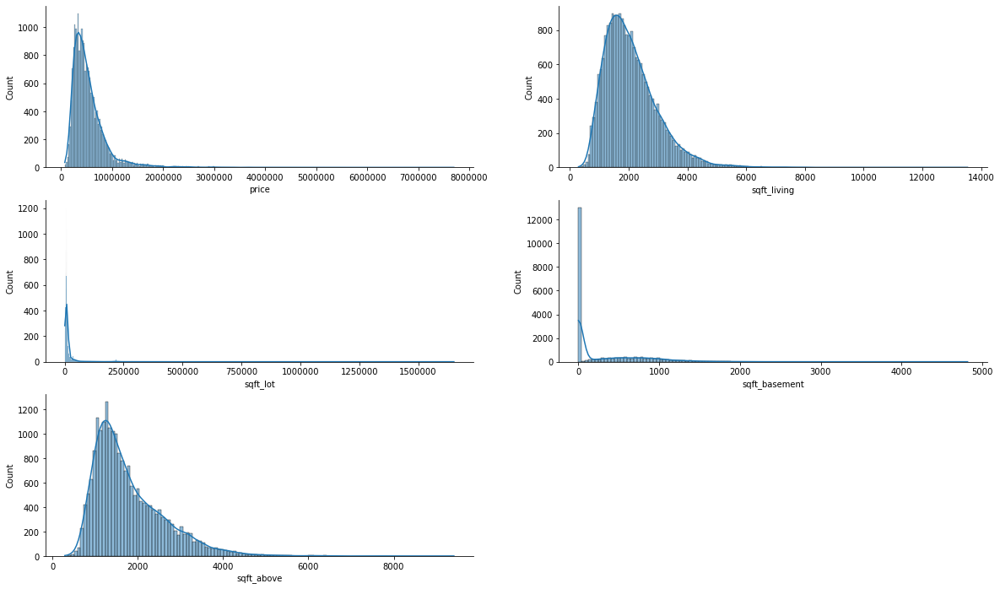

In [25]:
# Distribuitions
plt.subplots(figsize=(20,12))
cols = ['price', 'sqft_living', 'sqft_lot', 'sqft_basement', 'sqft_above']

for i, col in enumerate(cols):
    plt.subplot(3,2,i+1)
    sns.histplot(data = data,
                 x = col,
                 kde=True)

    plt.ticklabel_format(style='plain', axis='x')
    sns.despine()

In [26]:
# Skewness e Kurtosis para a distribuição do preço
print(f"Skewness: {data['price'].skew()}")
print(f"Kurtosis: {data['price'].kurt()}")

Skewness: 4.036107210012415
Kurtosis: 34.72522558297301


### A partir dessa informação podemos concluir que:

- A distribuição de preços não segue uma curva normal
- A distribuição de preços é positivamente assimétrica (cauda à direita)
- Provavelmente existem alguns outliers (por causa do alto valor do Kurtosis)

# 5. Análise multivariada

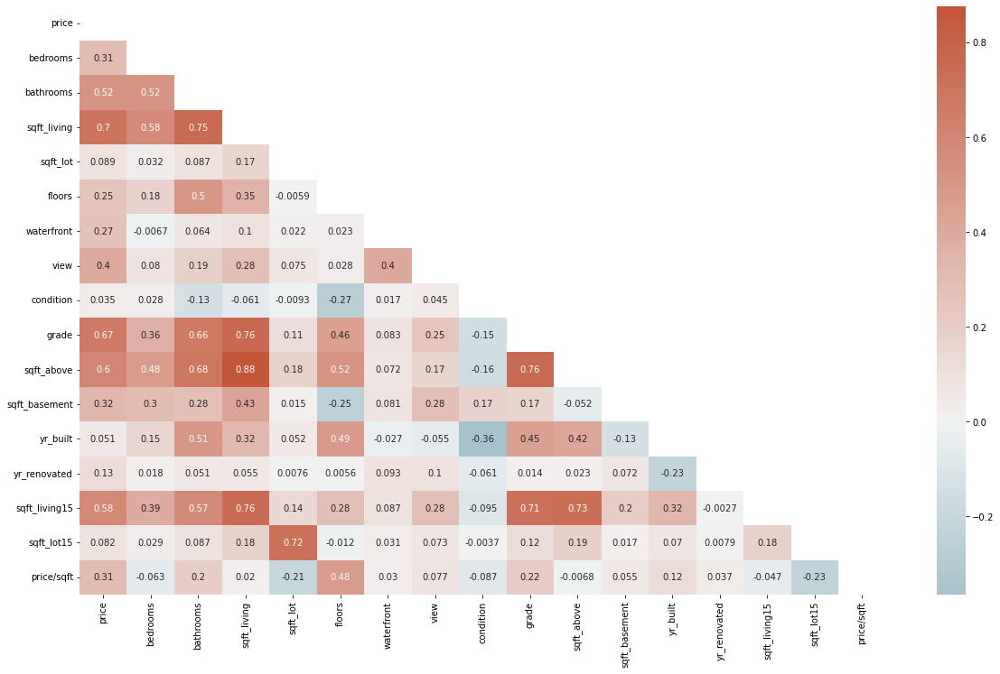

In [27]:
corr = data.drop(columns=['id', 'year', 'date', 'day', 'month', 'lat', 'long', 'zipcode']).corr()
mask = np.triu(np.ones_like(corr, dtype=bool))

plt.figure(figsize=(20,12))

sns.heatmap(corr,
            mask=mask,
            center=0,
            xticklabels=corr.columns, 
            yticklabels=corr.columns, 
            annot=True,
            cmap=sns.diverging_palette(220, 20, as_cmap=True));

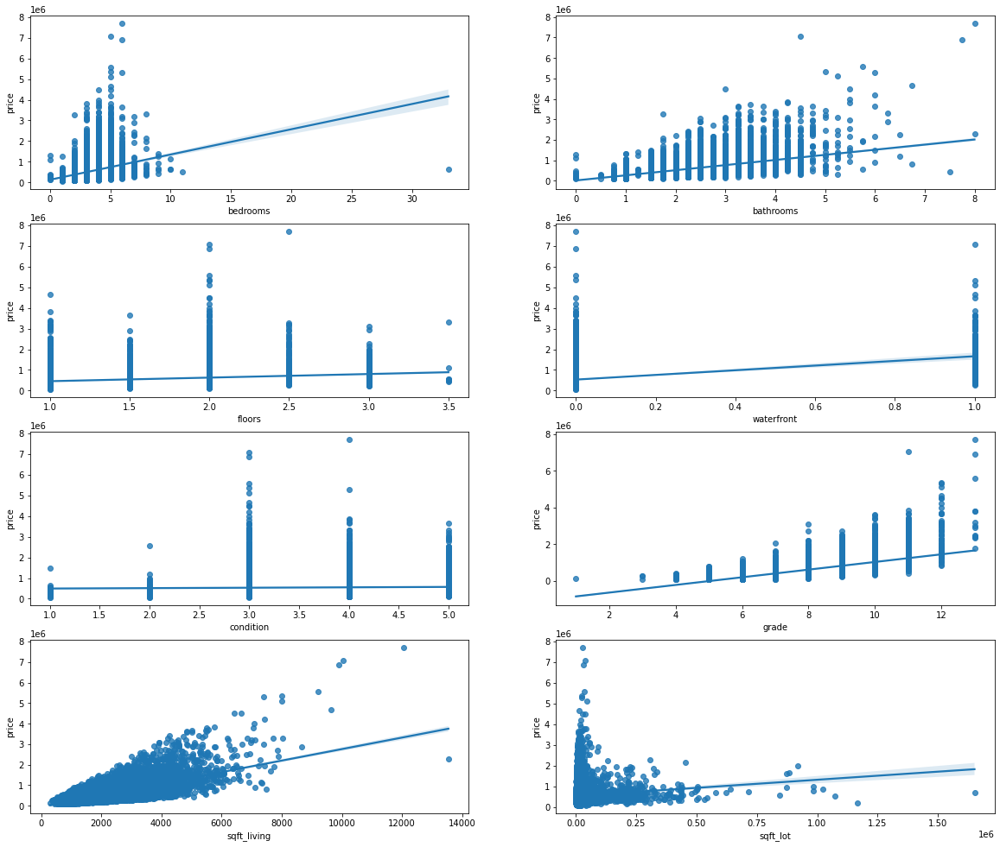

In [28]:
columns = ['bedrooms', 'bathrooms', 'floors', 'waterfront', 'condition', 'grade', 'sqft_living', 'sqft_lot']
count=1

plt.subplots(figsize=(20,17))
for column in columns:
    plt.subplot(4,2,count)
    sns.regplot(column, 'price', data=data)
    count+=1
    
plt.show;

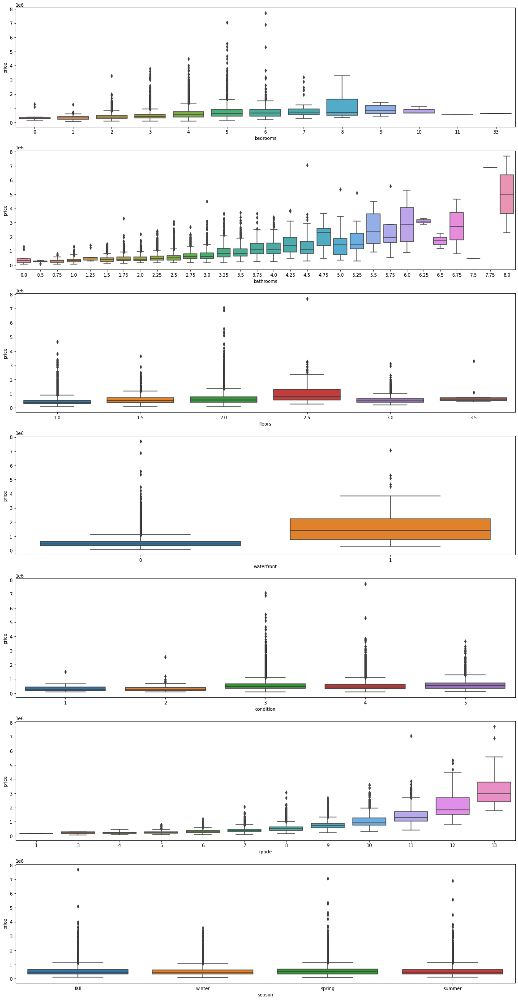

In [29]:
columns = ['bedrooms', 'bathrooms', 'floors', 'waterfront', 'condition', 'grade', 'season']
fig, axes = plt.subplots(ncols=1, nrows=7,figsize=(20,40))

for i, column in enumerate(columns):
    sns.boxplot(x=column, y='price',data=data, ax=axes[i])

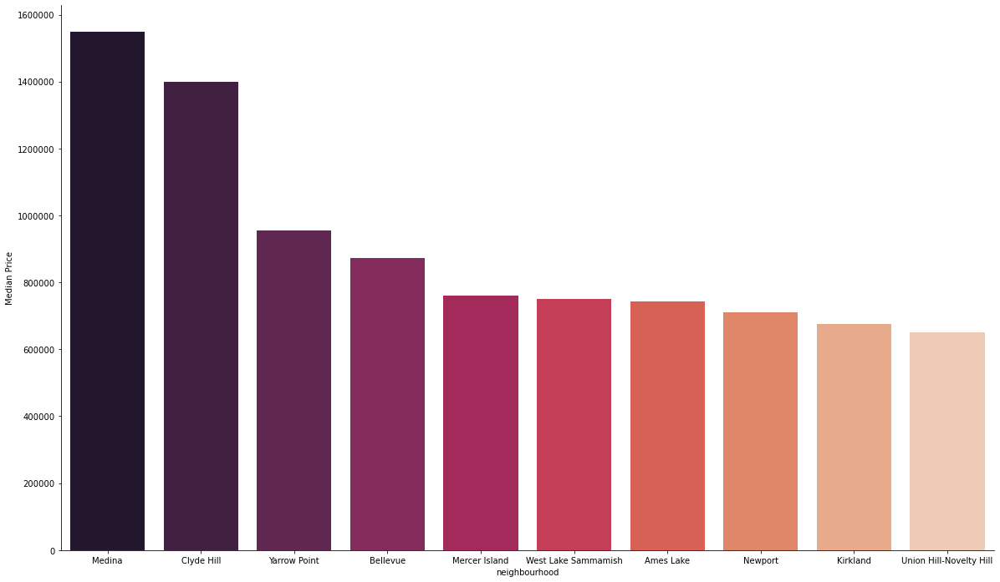

In [30]:
# Top 10 regiões com maior mediana do preço
plt.figure(figsize=(20,12))
df = data[['neighbourhood', 'price']].groupby('neighbourhood').median().reset_index().sort_values(by='price', ascending=False)

sns.barplot(x = 'neighbourhood', 
            y = 'price', 
            data = df.head(10),
            palette = 'rocket')

plt.ylabel('Median Price')

plt.ticklabel_format(style='plain', axis='y')

sns.despine()

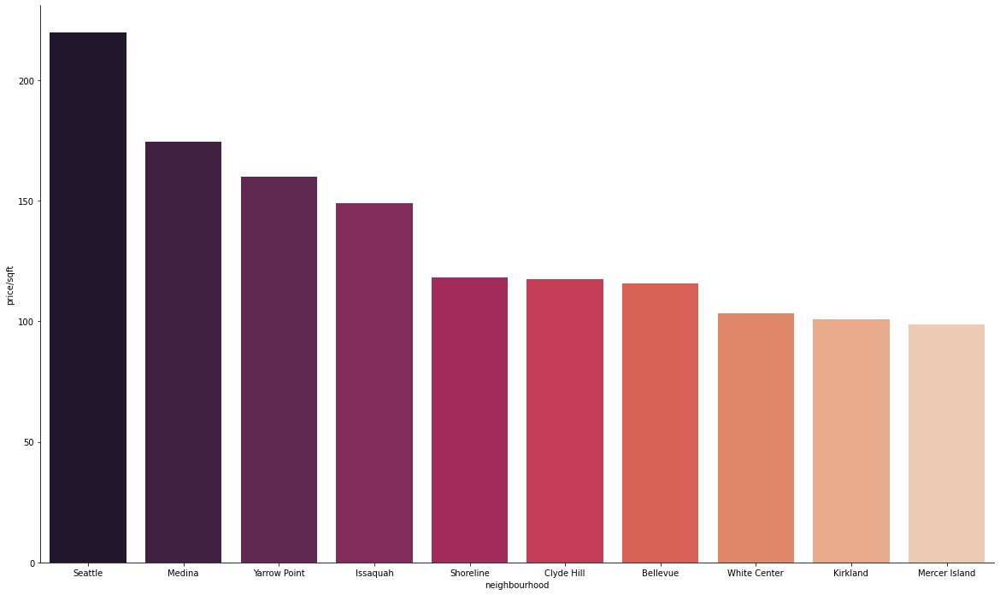

In [31]:
# Top 10 regiões que têm o pé quadrado mais caro, em média

plt.figure(figsize=(20,12))
df = data[['neighbourhood', 'price/sqft']].groupby('neighbourhood').mean().reset_index().sort_values(by='price/sqft', ascending=False)

sns.barplot(x = 'neighbourhood', 
            y = 'price/sqft', 
            data = df.head(10),
            palette = 'rocket')

plt.ticklabel_format(style='plain', axis='y')

sns.despine()

### Algumas conclusões

- Há casas com 0 quartos
- Existem casas com 33 quartos (talvez isso seja um erro de digitação)
- A casa mais cara tem 6 quartos
- O preço mediano de uma casa à beira-mar é maior
- Quando o "grade" aumenta, o preço tende a aumentar também
- O tamanho da área interna do imóvel, aparentemente, influencia no preço
- A condição da casa não parece afetar o preço
- Casa com mais banheiros tende a ser mais cara
- O número de andares não parece afetar o preço
- A estação do ano não parece afetar o preço
- A região de Medina tem um preço mediano mais alto
- A região de Seattle tem um preço/pé quadrado mais alto, em média.

# Representação Geográfica

In [43]:
df = data[['id', 'price', 'lat', 'long', 'sqft_lot']]

fig = px.scatter_mapbox(df,
                        lat = 'lat',
                        lon = 'long',
                        color = 'price',
                        size = 'price',
                        hover_name='id',
                        size_max=15,
                        zoom=10,
                        height=600,
                        color_continuous_scale=px.colors.sequential.Sunset)

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig

- As casas mais caras parecem ser à beira-mar

In [33]:
#lendo geofile
geofile = geopandas.read_file('app/datasets/Zipcodes_for_King_County_and_Surrounding_Area_(Shorelines)___zipcode_shore_area.geojson')

#Agrupando dados
df = data[['price', 'zipcode']].groupby('zipcode').mean().reset_index()
df.columns = ['ZIP', 'avg_price']

#Unindo tabelas 
geofile = geofile.merge(df, on='ZIP', how='inner')

In [34]:
#mapa base
m = folium.Map(location=(47.5052, -121.906), zoom_start=9)

marker_cluster = MarkerCluster().add_to(m)

for i, row in data.iterrows():
    folium.Marker(location=[row.lat,row.long],popup=f'ID: {row.id}\nPrice: R$ {row.price}\n Location: {data.location[i]}\n Neighbourhood: {data.neighbourhood[i]}').add_to(marker_cluster)

# mapa coroplético
fig = folium.Choropleth(
                    geo_data=geofile,
                    data=df,
                    columns=["ZIP", "avg_price"],
                    key_on="feature.properties.ZIP",
                    fill_color="YlOrRd",
                    fill_opacity=0.7,
                    line_opacity=0.2,
                    legend_name="Average Price",
                ).add_to(m)

# adicionando pop-up ao mapa coroplético
folium.GeoJsonTooltip(['ZIP']).add_to(fig.geojson)

m

- A região com CEP 98039 (Medina) tem um preço médio maior

# H1. Imóveis que possuem vista para água são 30% mais caros, na média.

<b>Falso</b>. Imóveis que possuem vista para água são, em média, 211.76% mais caros.

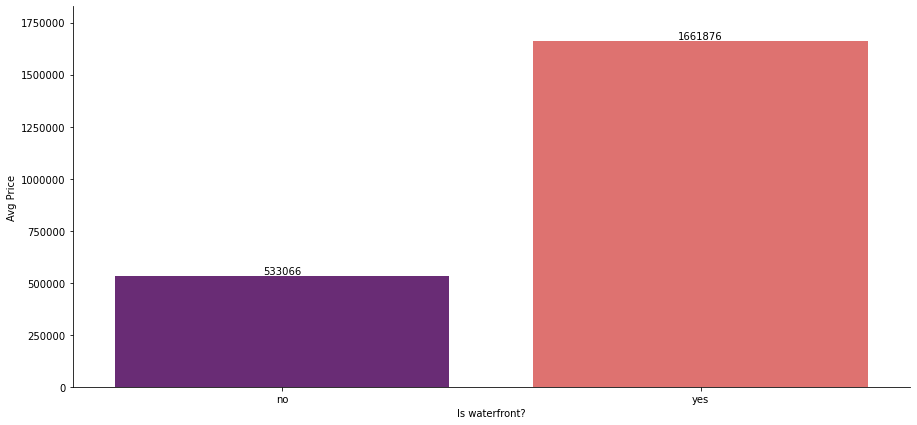

Imóveis que possuem vista para água são 211.76% mais caras, em média


In [35]:
#agrupa os dados
df = data[['is_waterfront', 'price']].groupby('is_waterfront').mean()

#gráfico
plt.figure(figsize=(15,7))
ax = sns.barplot(data = df,
                 x = df.index,
                 y = 'price',
                 palette='magma')

#renomear rótulos
plt.xlabel('Is waterfront?')
plt.ylabel('Avg Price')

#set bar label
ax.bar_label(ax.containers[0], label_type='edge', padding=0.2, fmt='%d')
ax.margins(y=0.1)

#suprimir notação científica
plt.ticklabel_format(style='plain', axis='y')

sns.despine()

#exibe gráfico
plt.show()

value = df.loc['yes', 'price'] / df.loc['no', 'price'] - 1

if value < 0:
    print(f"Imóveis que possuem vista para água são {abs(value):.2%} mais baratas, em média")
else:
    print(f"Imóveis que possuem vista para água são {value:.2%} mais caras, em média")

# H2. Imóveis com data de construção menor que 1955, são 50% mais baratos, na média.

<b>False</b>. Houses that were built before 1955 are only 0.40 % cheaper, on average.

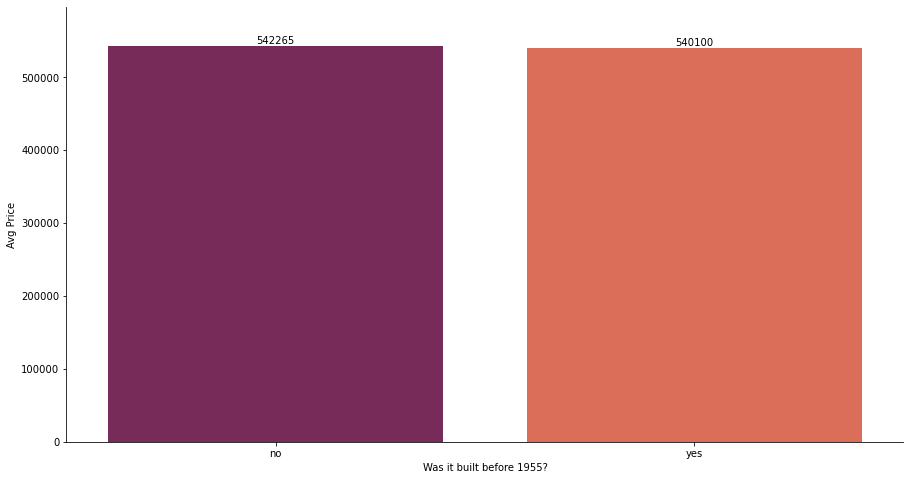

Imóveis com data de construção menor que 1955 são 0.40% mais baratas, em média


In [36]:
#agrupa os dados
df = data[['built_bef_1955', 'price']].groupby('built_bef_1955').mean()

#gráfico
plt.figure(figsize=(15,8))
ax = sns.barplot(x = df.index, 
                 y = 'price', 
                 data = df, 
                 palette='rocket')

#renomear rótulos
ax.set_xlabel('Was it built before 1955?')
ax.set_ylabel('Avg Price')

#rótulo das barras
ax.bar_label(ax.containers[0], label_type='edge', padding=0.5)
ax.margins(y=0.1)

sns.despine()

#exibe gráfico
plt.show()

value = df.loc['yes', 'price'] / df.loc['no', 'price'] - 1

if value < 0:
    print(f"Imóveis com data de construção menor que 1955 são {abs(value):.2%} mais baratas, em média")
else:
    print(f"Imóveis com data de construção menor que 1955 são {value:.2%} mais caras, em média")

# H3. No verão, o preço dos imóveis são, em média, 10% mais caro que no inverno.

<b>Falso</b>. No verão, os imóveis são, apenas, 3,98% mais caros que no inverno.

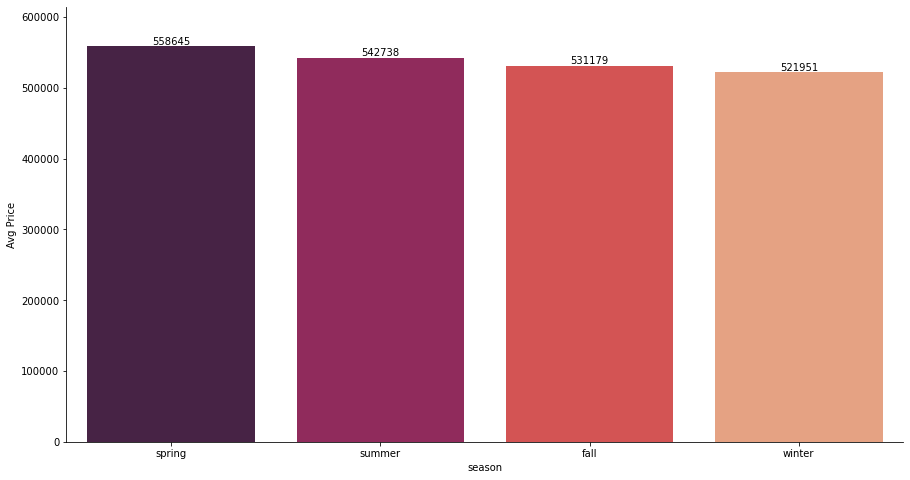

No verão, o preço dos imóveis são 3.98% mais caras, em média, que no inverno.


In [37]:
#agrupa os dados
df = data[['season', 'price']].groupby('season').mean()

#gráfico
plt.figure(figsize=(15,8))
ax = sns.barplot(x = df.index,
            y = df.price,
            data = df,
            order= df.sort_values(by='price', ascending=False).index,
            palette='rocket')

#renomear rótulos
plt.ylabel('Avg Price')

#rótulo das barras
ax.bar_label(ax.containers[0], label_type='edge', padding=0.2)
ax.margins(y=0.1)

sns.despine()

#exibe gráfico
plt.show()

value = df.loc['summer', 'price'] / df.loc['winter', 'price'] - 1

if value < 0:
    print(f"No verão, o preço dos imóveis são {abs(value):.2%} mais baratas, em média, que no inverno.")
else:
    print(f"No verão, o preço dos imóveis são {value:.2%} mais caras, em média, que no inverno.")

# H4. Os imóveis com condição nível 5 são, em média, pelo menos 10% mais caros.

<b>Verdadeiro</b>. Casas que têm condição 5 são 14,49% mais caras, em média.

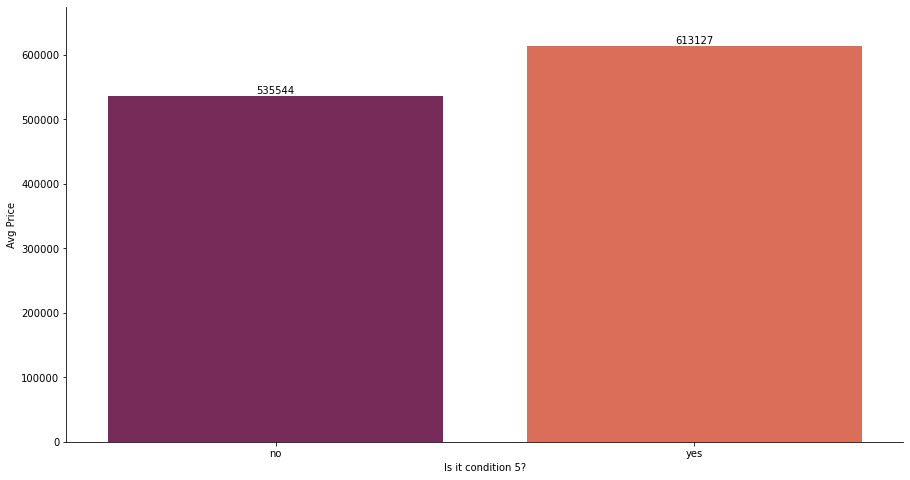

Casas que têm condição 5 são 14.49% mais caras, em média


In [38]:
#agrupa os dados
df = data[['is_condition5', 'price']].groupby('is_condition5').mean()

#gráfico
plt.figure(figsize=(15,8))
ax = sns.barplot(x = df.index,
                 y = 'price',
                 data = df,
                 palette= 'rocket')

#renomear rótulos
plt.xlabel('Is it condition 5?')
plt.ylabel('Avg Price')

#rótulo das barras
ax.bar_label(ax.containers[0], label_type='edge', padding=0.5)
ax.margins(y=0.1)

sns.despine()

#exibe gráfico
plt.show()

value = df.loc['yes', 'price'] / df.loc['no', 'price'] - 1

if value < 0:
    print(f"Casas que têm condição 5 são {abs(value):.2%} mais baratas, em média")
else:
    print(f"Casas que têm condição 5 são {abs(value):.2%} mais caras, em média")

# H5. Imóveis que não foram reformados são 30% mais baratos, na média.

<b>Verdadeiro</b>. Imóveis que não foram reformados são 30.21% mais baratos, em média.

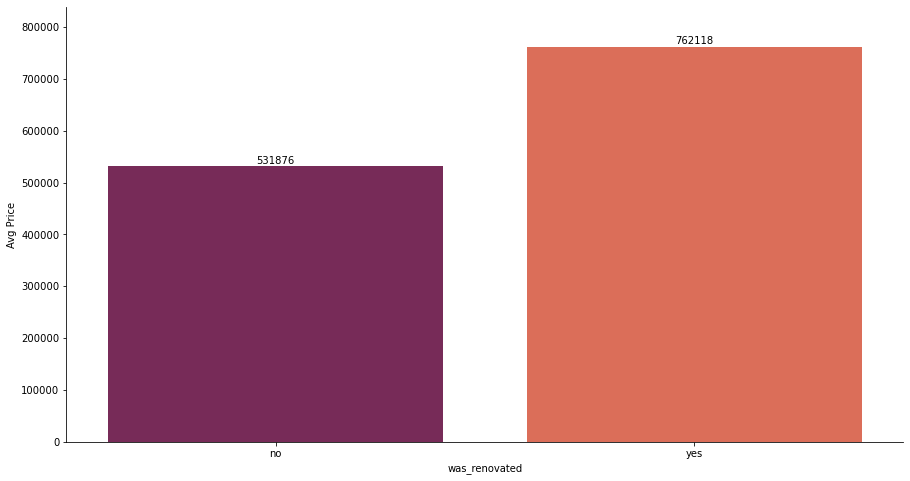

Imóveis que não foram reformados são 30.21% mais baratos, em média.


In [39]:
#agrupa os dados
df = data[['was_renovated', 'price']].groupby('was_renovated').mean()

#gráfico
plt.figure(figsize=(15,8))
ax = sns.barplot(x = df.index,
                 y = 'price',
                 data = df,
                 palette= 'rocket')

#renomear rótulos
plt.ylabel('Avg Price')

#rótulo dos dados
ax.bar_label(ax.containers[0], label_type='edge', padding=0.5)
ax.margins(y=0.1)

sns.despine()

#exibe gráfico
plt.show()

value = df.loc['no', 'price'] / df.loc['yes', 'price'] - 1

if value < 0:
    print(f"Imóveis que não foram reformados são {abs(value):.2%} mais baratos, em média.")
else:
    print(f"Imóveis que não foram reformados são {abs(value):.2%} mais caros, em média.")

# H6. Imóveis reformados após 2005 são 25% mais caros que os imóveis reformados em anos anteriores, em média.

<b>Falso</b>. Imóveis reformados após 2005 são 2.09% mais baratos, em média

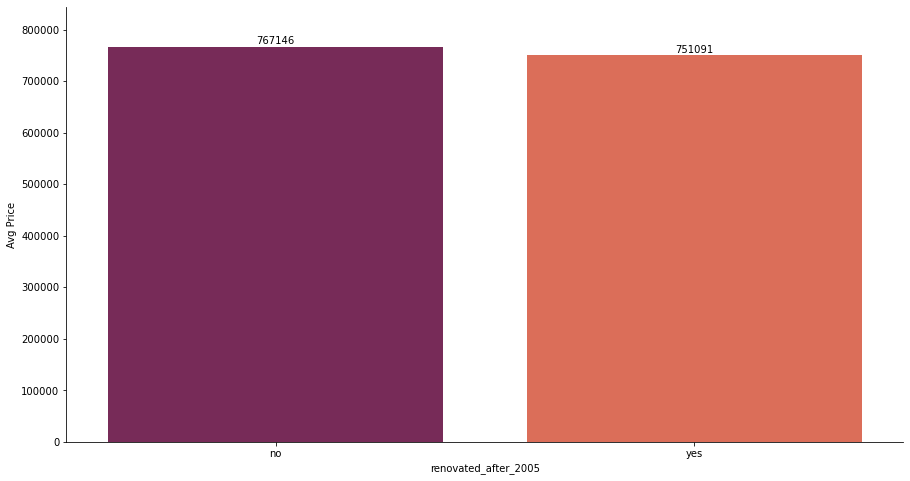

Imóveis reformados após 2005 são 2.09% mais baratos, em média


In [40]:
#agrupa dados
df = data[['renovated_after_2005', 'price']].groupby('renovated_after_2005').mean().drop('never_renovated')

#gráfico
plt.figure(figsize=(15,8))
ax = sns.barplot(x = df.index,
                 y = 'price',
                 data = df,
                 palette='rocket')

#renomeia rótulo
plt.ylabel('Avg Price')

#rótulo das barras
ax.bar_label(ax.containers[0], label_type='edge', padding=0.5)
ax.margins(y=0.1)

sns.despine()

#dexibe gráfico
plt.show();

value = df.loc['yes', 'price'] / df.loc['no', 'price'] - 1

if value < 0:
    print(f"Imóveis reformados após 2005 são {abs(value):.2%} mais baratos, em média")

else:
    print(f"Imóveis reformados após 2005 são {abs(value):.2%} mais caros, em média")

# H7. O preço dos imóveis na região de Medina é, em média, 45% mais caro que na região de Bellevue

<b>False</b> O preço dos imóveis na região de Medina é, em média, 73,24% mais caro que na região de Bellevue

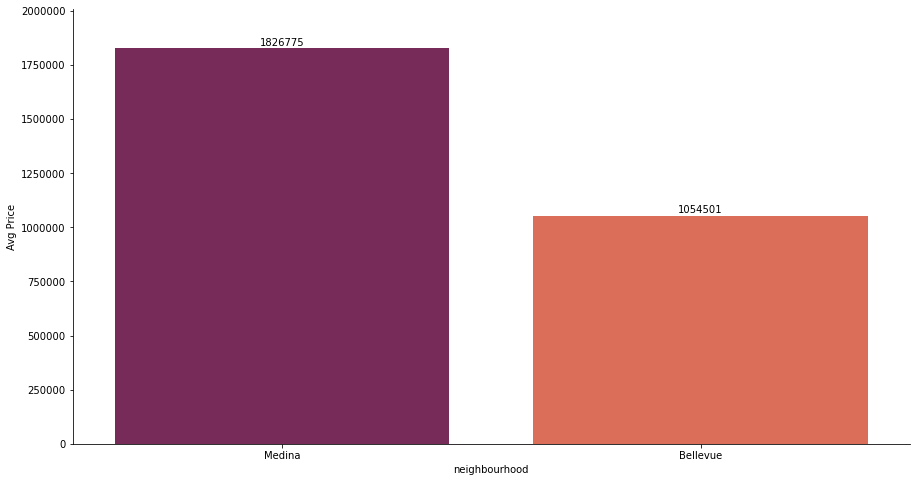

O preço dos imóveis na região de Medina é, em média, 73.24% mais caro que na região de Bellevue.


In [41]:
#agrupa os dados
df = data[['neighbourhood', 'price']].groupby('neighbourhood').mean().loc[['Medina', 'Bellevue']]

#gráfico
plt.figure(figsize=(15,8))
ax = sns.barplot(x = df.index,
            y = 'price',
            data = df,
            palette='rocket')

#renomear rótulos
plt.ylabel('Avg Price')

#rótulo das barras
ax.bar_label(ax.containers[0], label_type='edge', padding=0.5, fmt = '%d')
ax.margins(y=0.1)

#desativa a notação científica
plt.ticklabel_format(style='plain', axis='y')

sns.despine()

#exibe gráfico
plt.show();

value = df.loc['Medina', 'price'] / df.loc['Bellevue', 'price'].mean() - 1

if value < 0:
    print(f"O preço dos imóveis na região de Medina é, em média, {abs(value):.2%} mais barato que na região de Bellevue.")
else:
    print(f"O preço dos imóveis na região de Medina é, em média, {value:.2%} mais caro que na região de Bellevue.")